## Question 1  
“Can you think of a few applications for a sequence-to-sequence RNN? What about a sequence-to-vector RNN, and a vector-to-sequence RNN?”

* seq2seq RNN applications is time series forcasting  
* seq2vec RNN applications are sentiment analysis or time series forcasting. 
* vec2seq RNN applications are text generation or music generation. 

## Question 2  
“How many dimensions must the inputs of an RNN layer have? What does each dimension represent? What about its outputs?”

Dimensions of the RNN layer is (sentence length x input feature), 
however, in RNN one hidden input which is  hidden state from previous time step.  
So, the total dimensions of the input is (sentence length x (input feature + num hidden state))

## Question 3  
“If you want to build a deep sequence-to-sequence RNN, which RNN layers should have return_sequences=True? What about a sequence-to-vector RNN?”

* For seq2seq RNN, all of the RNN layers have to return sequences.  
* For seq2vec RNN, all but the top one have to return sequences.

## Question 4  
“Suppose you have a daily univariate time series, and you want to forecast the next seven days. Which RNN architecture should you use?”  


There are 2 choices as follows:  
1. seq2vec RNN, the input is the historical data and the output is the next seven day of the latest historical data.  
    1. _Input_:  
        in1, in2, in3, in4
    2. _Target at the last step_:
        in5, in6, in7, in8, ..., in11
2. seq2seq RNN, the input is the historical data and the output is the data of next sevenday of each timestep of the historical data.
    1. _Input_:  
        in1, in2, in3, in4
    2. _Target at the last step_:  
        [in2, in3, in4, in5, ..., in9],[in3, in4, in5, in6, ..., in10], ... 

## Question 5  
“What are the main difficulties when training RNNs? How can you handle them?”

* The main difficulties of the RNN is exploding gradient due to the nature of reusing the parameters. 
Gradient clipping, saturate acitvation (sigmoid or tanh) layer normalization and dropout can alleviate this problems.  
* The short memory is also the problems of the RNN, we should use LSTM or GRU of Wavenet to increase this capabilities. Applying 1D Convolutional to reduce sequence length and capture the features of series also help.

## Question 6

## Question 7  
“Why would you want to use 1D convolutional layers in an RNN?”

* To reduce the sequence length, since the RNN main problems is the short memory.  
* To capture features that hard to detect in time series.

## Question 8  
“Which neural network architecture could you use to classify videos?”

There are 2 features in the videos, image and audio.  
* For image, we should, for example, take and image 1 frame per second and feed in to CNN to generate sequences of features. Then, feed these sequences to RNN model and have RNN classify the video. 
* For audio, we can implement 1D Conv to reduce temporal resolution (downsampling) the frequency of audio to match the output sequences of image features. Then concat these 2 outputs and feed to RNN to classify the video.

## Question 9

In [144]:
import tensorflow.keras.datasets as tfds
from tensorflow.data import TFRecordDataset
from tensorflow.io import TFRecordWriter
import urllib.request
import os
import tarfile
import tensorflow as tf

In [145]:
os.makedirs('datasets/ch15-processing', exist_ok = True)

# Download SketchRNN file 
DOWNLOAD_ROOT = "http://download.tensorflow.org/data/"
FILENAME = "quickdraw_tutorial_dataset_v1.tar.gz"

urllib.request.urlretrieve(DOWNLOAD_ROOT+FILENAME, 'datasets/ch15-processing/'+FILENAME)

reffile = tarfile.open('datasets/ch15-processing/'+FILENAME)
reffile.extractall('datasets/ch15-processing/')

In [146]:
files = os.listdir('datasets/ch15-processing/')

train_files = list(filter(lambda file: "training.tfrecord-" in file, files))
test_files = list(filter(lambda file: "eval.tfrecord-" in file, files))
train_classes = 'training.tfrecord.classes'
test_classes = 'eval.tfrecord.classes'

# append file path
train_files = ['datasets/ch15-processing/' + file for file in train_files]
test_files = ['datasets/ch15-processing/' + file for file in test_files]

In [177]:
train = TFRecordDataset(train_files)

# count = 0

# for data in train:
#     count += 1
    
# print(count)

KeyboardInterrupt: 

In [148]:
def parse(databatch):
    features_description = {
        "ink": tf.io.VarLenFeature(dtype=tf.float32),
        "shape": tf.io.FixedLenFeature([2], dtype=tf.int64),
        "class_index": tf.io.FixedLenFeature([1], dtype=tf.int64)
    }
    
    examples = tf.io.parse_example(databatch, features_description)
    flat_sketches = tf.sparse.to_dense(examples["ink"])
    sketches = tf.reshape(flat_sketches, shape=[tf.size(databatch), -1, 3])
    lengths = examples["shape"][:, 0]
    labels = examples["class_index"][:, 0]
    return (sketches, lengths, labels)

def load_dataset(filepaths, batch_size=32, shuffle_buffer_size=None,
                      n_parse_threads=5, n_read_threads=5, cache=False):
    
    dataset = TFRecordDataset(filepaths, num_parallel_reads=n_read_threads)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)

    dataset = dataset.batch(batch_size)
    dataset = dataset.map(parse, num_parallel_calls=n_parse_threads)
    return dataset.prefetch(1)

In [149]:
trainset = load_dataset(train_files)

In [150]:
for data in trainset.take(10):
    print(data[2])

tf.Tensor(
[22  4  9  5  2 25 10 11 14  6 39 46 24 18  7 44 51 31 19 12 57 52 36 30
 13 66 25 42 32 17 69 19], shape=(32,), dtype=int64)
tf.Tensor(
[  5   0  26  77  63  47  47   2  79  64  54  29  33   7  67  62  71  38
  85  70  80  36  65  13  73  90  86  82 112  75  94  88], shape=(32,), dtype=int64)
tf.Tensor(
[106 108  87  96  95 111  51  62 104 110 130 134   3 117  82 136 101  93
 128 115  65 116 100 138 139 161  69  81 144  23 162 158], shape=(32,), dtype=int64)
tf.Tensor(
[ 12 146 141 163   0 127  47 147 172  30  20 166 149 128 171 137 173 132
 179 132 107 175  84 181 207 143 178 174 107 209 131 180], shape=(32,), dtype=int64)
tf.Tensor(
[188 211 192 157 195 198 222 228 150 200 204 223 184  18 202 208 220 198
 168  28  96 225 100 169 129 213 227 173 146  92 215 216], shape=(32,), dtype=int64)
tf.Tensor(
[102 174 102 218 165  75  38  47 220 218 258 120 125 110 221   6 190 221
  86  70 103 196 108 188 249 173 163 230  20 161  64 172], shape=(32,), dtype=int64)
tf.Tensor(
[237  9

In [155]:
with open('datasets/ch15-processing/' + train_classes, 'r') as f:
    train_labels_raw = f.readlines()
    train_labels = [label.strip().lower() for label in train_labels_raw]
    
with open('datasets/ch15-processing/' + test_classes, 'r') as f:
    test_labels_raw = f.readlines()
    test_labels = [label.strip().lower() for label in test_labels_raw]

In [156]:
class_names = train_labels

In [157]:
trainset = load_dataset(train_files)
validset = load_dataset(test_files[:5])
testset = load_dataset(test_files[5:])

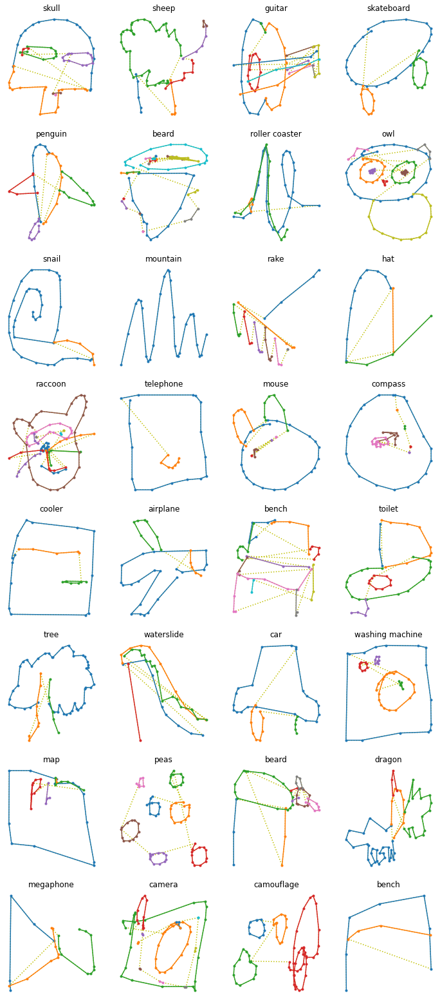

In [175]:
import matplotlib.pyplot as plt
import numpy as np

def draw_sketch(sketch, label=None):
    origin = np.array([[0., 0., 0.]])
    sketch = np.r_[origin, sketch]
    stroke_end_indices = np.argwhere(sketch[:, -1]==1.)[:, 0]
    coordinates = np.cumsum(sketch[:, :2], axis=0)
    strokes = np.split(coordinates, stroke_end_indices + 1)
    title = class_names[label.numpy()] if label is not None else "Try to guess"
    plt.title(title)
    plt.plot(coordinates[:, 0], -coordinates[:, 1], "y:")
    for stroke in strokes:
        plt.plot(stroke[:, 0], -stroke[:, 1], ".-")
    plt.axis("off")

def draw_sketches(sketches, lengths, labels):
    n_sketches = len(sketches)
    n_cols = 4
    n_rows = (n_sketches - 1) // n_cols + 1
    plt.figure(figsize=(n_cols * 3, n_rows * 3.5))
    for index, sketch, length, label in zip(range(n_sketches), sketches, lengths, labels):
        plt.subplot(n_rows, n_cols, index + 1)
        draw_sketch(sketch[:length], label)
    plt.show()

for sketches, lengths, labels in trainset.take(1):
    draw_sketches(sketches, lengths, labels)

In [193]:
def crop_long_sketches(dataset, max_length=100):
    return dataset.map(lambda inks, lengths, labels: (inks[:, :max_length], labels))

cropped_train_set = crop_long_sketches(trainset)
cropped_valid_set = crop_long_sketches(validset)
cropped_test_set = crop_long_sketches(testset)

In [192]:
## Now, we have time series dataset (strokes of the picture)
## and target (class of the image). We, then, can train a RNN model to predict the class from given strokes.

model = tf.keras.models.Sequential([
    tf.keras.layers.Conv1D(32, kernel_size=5, strides=2, activation="relu", input_shape = (None, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=5, strides=2, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(128, kernel_size=3, strides=2, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(128, return_sequences=True),
    tf.keras.layers.LSTM(128),
    tf.keras.layers.Dense(len(class_names), activation="softmax")
])

model.compile(loss = 'sparse_categorical_crossentropy', metrics=['acc'], optimizer = 'adam')

In [194]:
# model.fit()
## The model is taking too long to train!

## Question 10

In [28]:
import tensorflow.keras as keras
import urllib.request
import ssl
import tarfile
import csv
import os
import numpy as np
import tensorflow as tf

DOWNLOAD_ROOT = "http://github.com/ageron/handson-ml2/raw/master/datasets/jsb_chorales/"
FILENAME = "jsb_chorales.tgz"

# ssl._create_default_https_context = ssl._create_unverified_context
# urllib.request.urlretrieve(DOWNLOAD_ROOT + FILENAME, 'datasets/ch15-processing/' + FILENAME)

In [4]:
# ref_file = tarfile.open('datasets/ch15-processing/' + FILENAME)
# ref_file.extractall('datasets/ch15-processing/')

In [5]:
BACH_TRAIN_PATH = 'datasets/ch15-processing/train'
BACH_VALID_PATH = 'datasets/ch15-processing/valid'
BACH_TEST_PATH = 'datasets/ch15-processing/test'

basch_train_files = os.listdir(BACH_TRAIN_PATH)
basch_valid_files = os.listdir(BACH_VALID_PATH)
basch_test_files = os.listdir(BACH_TEST_PATH)

In [35]:
list(np.array([1,2,3])).shape

AttributeError: 'list' object has no attribute 'shape'

In [52]:
def read_csv_file(filepath, filename):
    
    with open(filepath + '/' + filename, 'r') as f:
        next(f)
        raw_data = f.readlines()
        
        notes = []
        
        for ind, note in enumerate(raw_data):
            note_list = list(np.array(note.strip().split(','), dtype ='int32'))
            notes.append(note_list)
        
    return notes

def load_chorales(path, filenames):
    
    return [read_csv_file(path, filename) for filename in filenames]

In [55]:
## Alternative method
# import pandas as pd

# def load_chorales(path, filenames):
#     return [pd.read_csv(os.path.join(path, file)).values.tolist() for file in filenames]

In [53]:
train_chorales = load_chorales(BACH_TRAIN_PATH, basch_train_files)
valid_chorales = load_chorales(BACH_VALID_PATH, basch_valid_files)
test_chorales = load_chorales(BACH_TEST_PATH, basch_test_files)

In [54]:
print(type(train_chorales))
print(type(train_chorales[0]))
print(type(train_chorales[0][0]))
print(train_chorales[0][0])

<class 'list'>
<class 'list'>
<class 'list'>
[66, 61, 57, 54]


In [248]:
note = set()

for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            note |= set(chord)

min_note = min(note - {0})
max_note = max(note)
n_notes = len(note)
print(n_notes)
print(min(note - {0}))
print(max(note))

47
36
81


In [22]:
from IPython.display import Audio

def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = np.round(note_duration * frequencies) / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

In [25]:
for index in range(3):
    play_chords(train_chorales[index])

In [239]:
print(len(train_chorales[0]))

180


In [234]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

In [250]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales, shuffle_buffer_size=1000)
test_set = bach_dataset(test_chorales, shuffle_buffer_size=1000)

![title](./figures/bach_data_pipeline_1.jpg)
![title](./figures/bach_data_pipeline_3.jpg)
![title](./figures/bach_data_pipeline_2.jpg)
![title](./figures/bach_data_pipeline_4.jpg)

In [285]:
tf.keras.backend.clear_session()

n_embedding_dims = 5

model = keras.models.Sequential([
    keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    keras.layers.BatchNormalization(),
    keras.layers.LSTM(256, return_sequences=True),
    keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 5)           235       
_________________________________________________________________
conv1d (Conv1D)              (None, None, 32)          352       
_________________________________________________________________
batch_normalization (BatchNo (None, None, 32)          128       
_________________________________________________________________
conv1d_1 (Conv1D)            (None, None, 48)          3120      
_________________________________________________________________
batch_normalization_1 (Batch (None, None, 48)          192       
_________________________________________________________________
conv1d_2 (Conv1D)            (None, None, 64)          6208      
_________________________________________________________________
batch_normalization_2 (Batch (None, None, 64)          2

In [286]:
model.compile(loss='sparse_categorical_crossentropy', metrics=['acc'], optimizer = 'adam')

model.fit(train_set, epochs = 15, validation_data=valid_set)

Epoch 1/15
98/98 [==============================] - 56s 569ms/step - loss: 1.9547 - acc: 0.5091 - val_loss: 3.6416 - val_acc: 0.0780
Epoch 2/15
98/98 [==============================] - 57s 583ms/step - loss: 0.8925 - acc: 0.7676 - val_loss: 3.6648 - val_acc: 0.1139
Epoch 3/15
98/98 [==============================] - 49s 504ms/step - loss: 0.7413 - acc: 0.7940 - val_loss: 3.3101 - val_acc: 0.1413
Epoch 4/15
98/98 [==============================] - 45s 461ms/step - loss: 0.6669 - acc: 0.8091 - val_loss: 2.7051 - val_acc: 0.2829
Epoch 5/15
98/98 [==============================] - 45s 457ms/step - loss: 0.6143 - acc: 0.8204 - val_loss: 1.6531 - val_acc: 0.5272
Epoch 6/15
98/98 [==============================] - 44s 454ms/step - loss: 0.5722 - acc: 0.8305 - val_loss: 0.9260 - val_acc: 0.7378
Epoch 7/15
98/98 [==============================] - 45s 461ms/step - loss: 0.5346 - acc: 0.8392 - val_loss: 0.6698 - val_acc: 0.8089
Epoch 8/15
98/98 [==============================] - 44s 452ms/step - 

In [287]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = model.predict_classes(arpegio)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis = -1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [256]:
seed_chords = test_chorales[2][:8]
play_chords(seed_chords, amplitude=0.2)

In [289]:
new_chorale = generate_chorale(model, seed_chords, 56)
play_chords(new_chorale)

In [321]:
## Generator chorale with rescale probabilites
def generate_chorale_v2(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [320]:
new_chorale = generate_chorale_v2(model, seed_chords, 56, 1)
play_chords(new_chorale)

[[2.3993768e-04 3.7692567e-05 6.6419502e-06 3.3275566e-05 2.9012144e-05
  2.6217941e-04 4.6430479e-05 2.2449497e-06 1.8667692e-04 5.9858674e-05
  2.7574102e-05 4.5733595e-06 3.7626840e-05 2.1295224e-05 7.1964344e-08
  9.9548524e-06 1.5335353e-06 4.3627319e-06 4.9656419e-06 1.1568603e-06
  1.3186295e-04 1.8266504e-05 4.4388876e-06 3.0896861e-06 1.9594687e-05
  1.1563717e-03 1.2101919e-05 3.4757298e-03 2.1182809e-03 7.8745205e-03
  8.1057167e-03 1.3839041e-02 1.6164503e-01 3.5038473e-05 6.8476969e-01
  3.8588425e-04 1.1597325e-02 7.7881776e-02 1.4742452e-04 2.5306318e-02
  2.0195849e-04 1.4756799e-04 9.7564625e-06 2.5378289e-05 3.3134522e-05
  5.3220497e-06 3.2343694e-05]]
tf.Tensor(
[[ -8.335132   -10.186048   -11.922105   -10.310687   -10.447796
   -8.246482    -9.977554   -13.006827    -8.586131    -9.723524
  -10.498633   -12.295262   -10.187793   -10.757028   -16.447096
  -11.51745    -13.387935   -12.342412   -12.212968   -13.669801
   -8.933747   -10.910441   -12.325107   -12.6874

In [315]:
tf.math.log(1e-3)/

<tf.Tensor: shape=(), dtype=float32, numpy=-6.9077554>